In [15]:
from mmdet.apis import init_detector, inference_detector
import mmcv

In [2]:
config_file = '/opt/ml/level2_project/baseline/configs/yolox/yolox_x_8x8_300e_coco.py' 
checkpoint_file = '/opt/ml/level2_project/baseline/work_dirs/exp12/epoch_21.pth'

In [3]:
model = init_detector(config_file, checkpoint_file, device='cuda:0') 

load checkpoint from local path: /opt/ml/level2_project/baseline/work_dirs/exp12/epoch_21.pth
The model and loaded state dict do not match exactly

unexpected key in source state_dict: ema_backbone_stem_conv_conv_weight, ema_backbone_stem_conv_bn_weight, ema_backbone_stem_conv_bn_bias, ema_backbone_stem_conv_bn_running_mean, ema_backbone_stem_conv_bn_running_var, ema_backbone_stem_conv_bn_num_batches_tracked, ema_backbone_stage1_0_conv_weight, ema_backbone_stage1_0_bn_weight, ema_backbone_stage1_0_bn_bias, ema_backbone_stage1_0_bn_running_mean, ema_backbone_stage1_0_bn_running_var, ema_backbone_stage1_0_bn_num_batches_tracked, ema_backbone_stage1_1_main_conv_conv_weight, ema_backbone_stage1_1_main_conv_bn_weight, ema_backbone_stage1_1_main_conv_bn_bias, ema_backbone_stage1_1_main_conv_bn_running_mean, ema_backbone_stage1_1_main_conv_bn_running_var, ema_backbone_stage1_1_main_conv_bn_num_batches_tracked, ema_backbone_stage1_1_short_conv_conv_weight, ema_backbone_stage1_1_short_conv_bn_w

/opt/ml/baseline/mmdetection/mmdet/apis/inference.py:51: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '


In [8]:
from showbox import get_infer_box, get_ann_box 
import matplotlib.pyplot as plt 
from pycocotools.coco import COCO 

In [9]:
root = '/opt/ml/dataset'
coco = COCO('/opt/ml/dataset/train.json') 

loading annotations into memory...
Done (t=0.21s)
creating index...
index created!


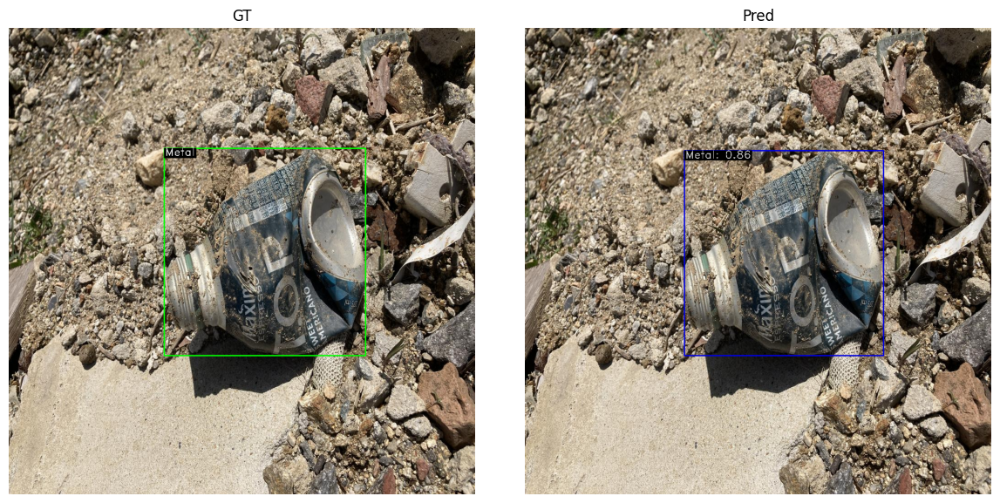

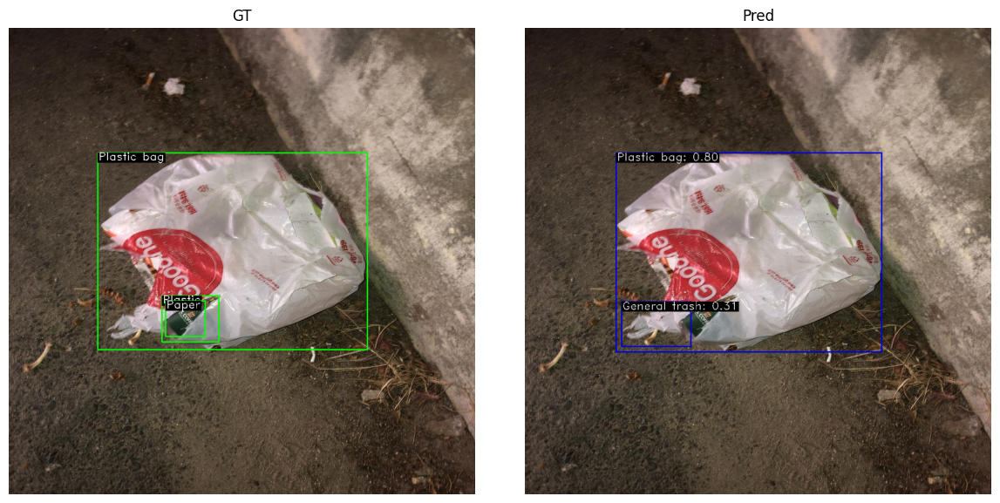

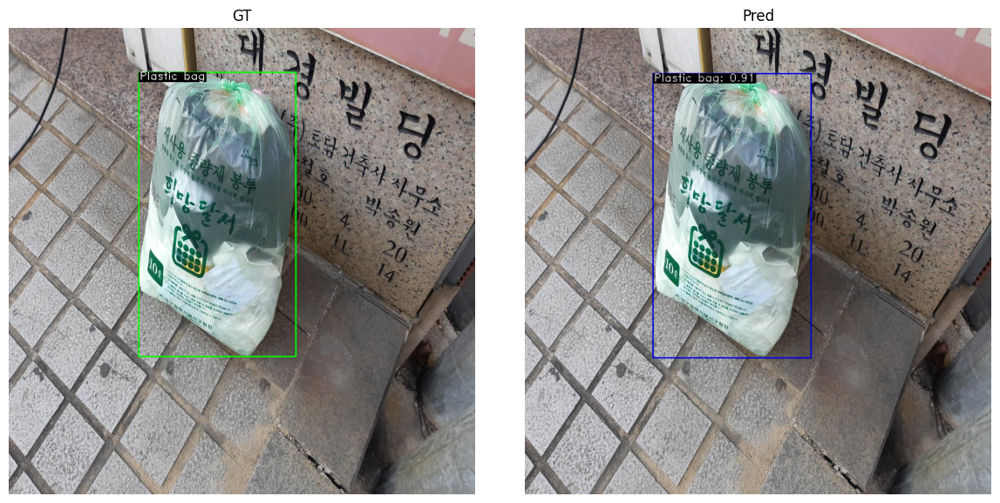

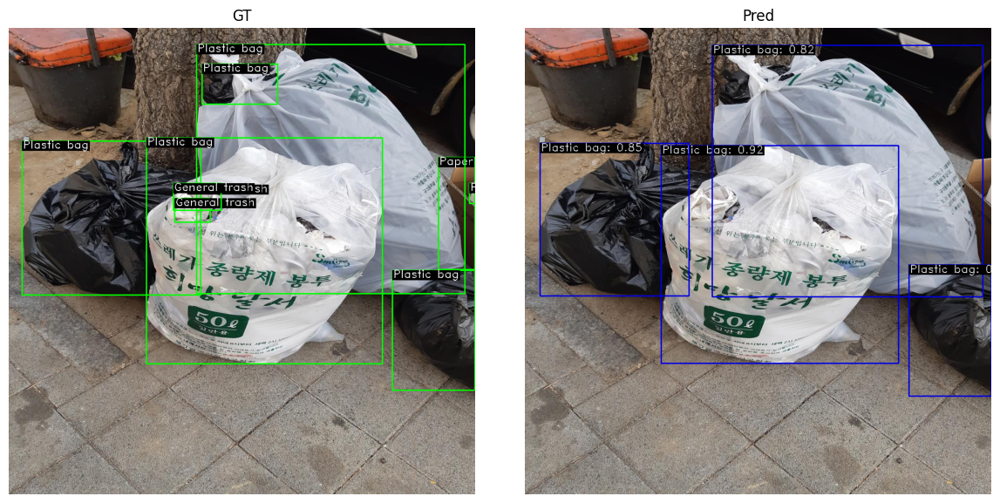

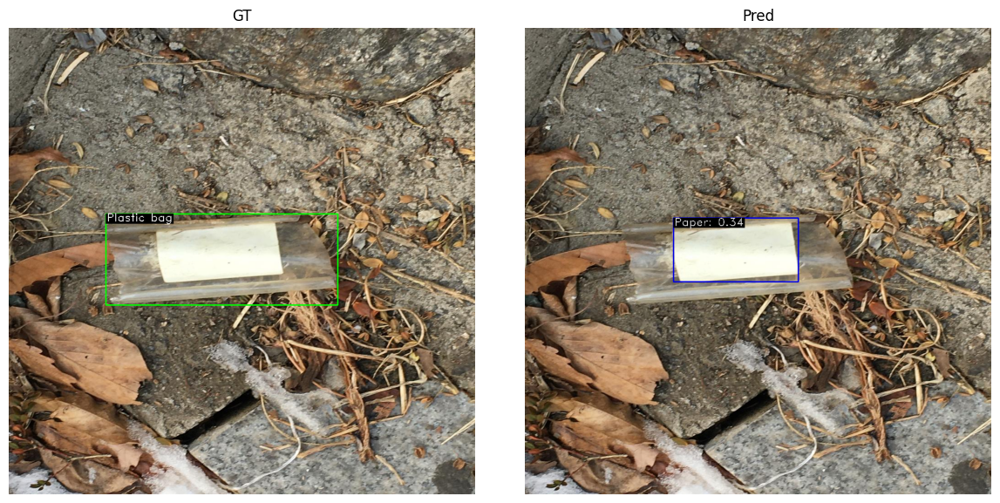

...

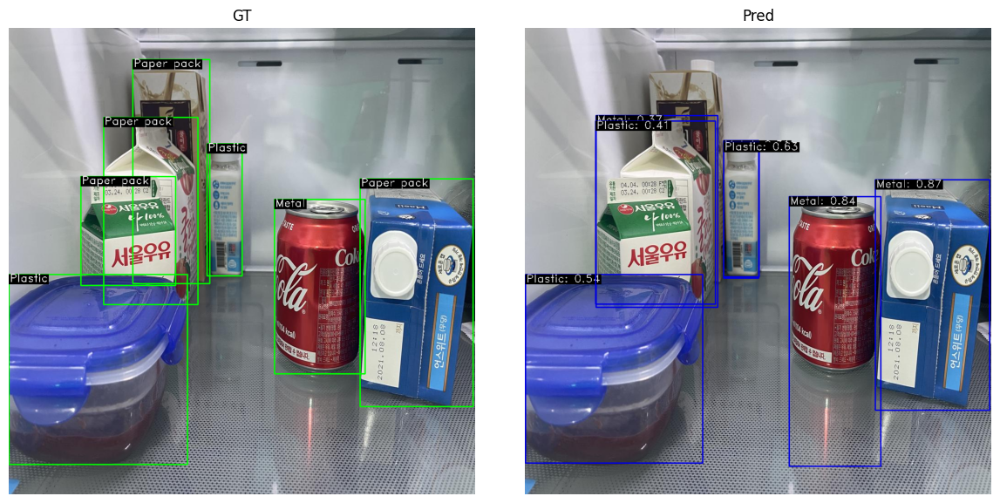

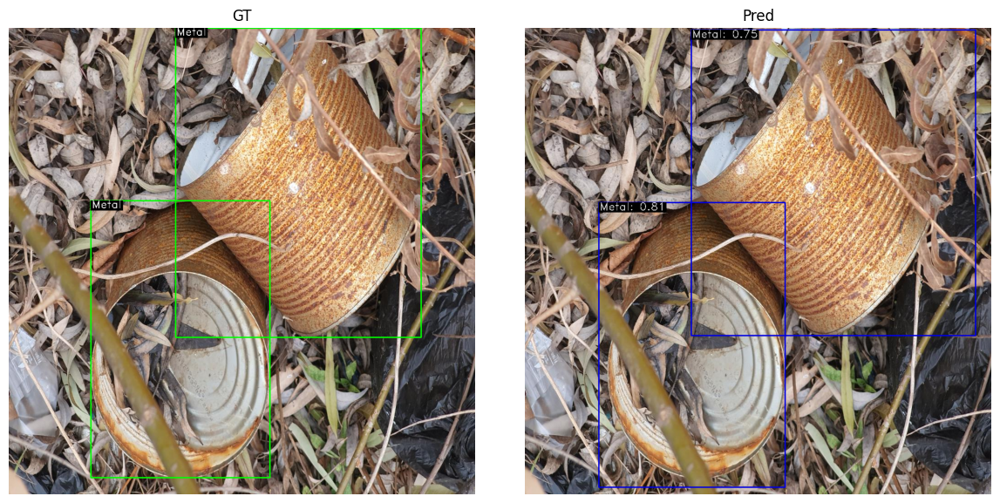

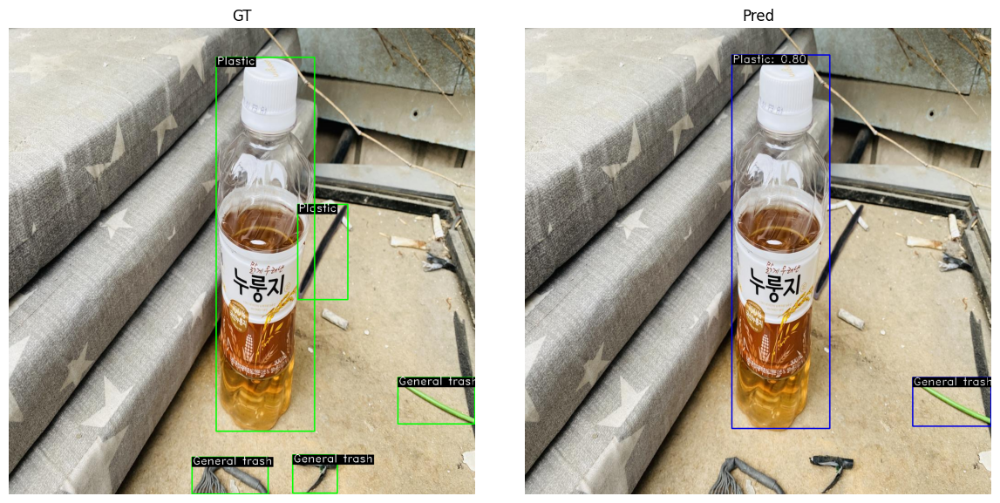

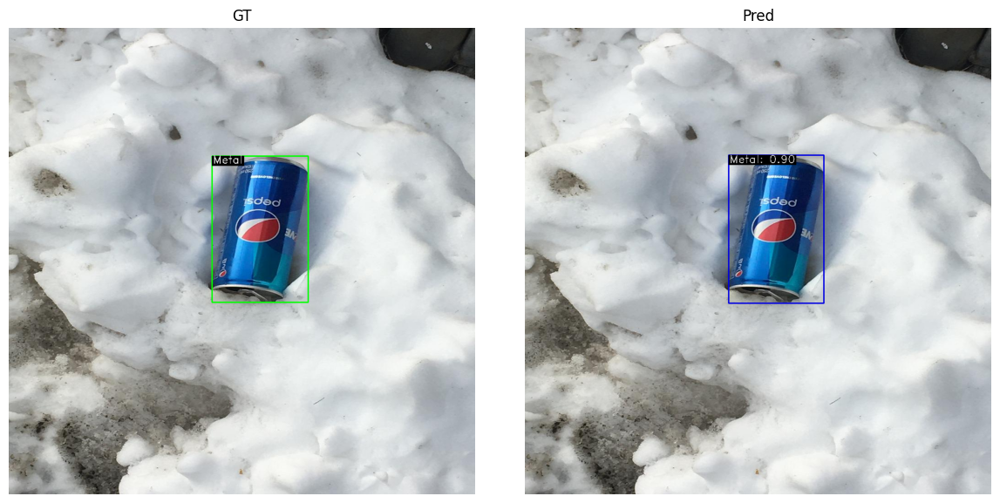

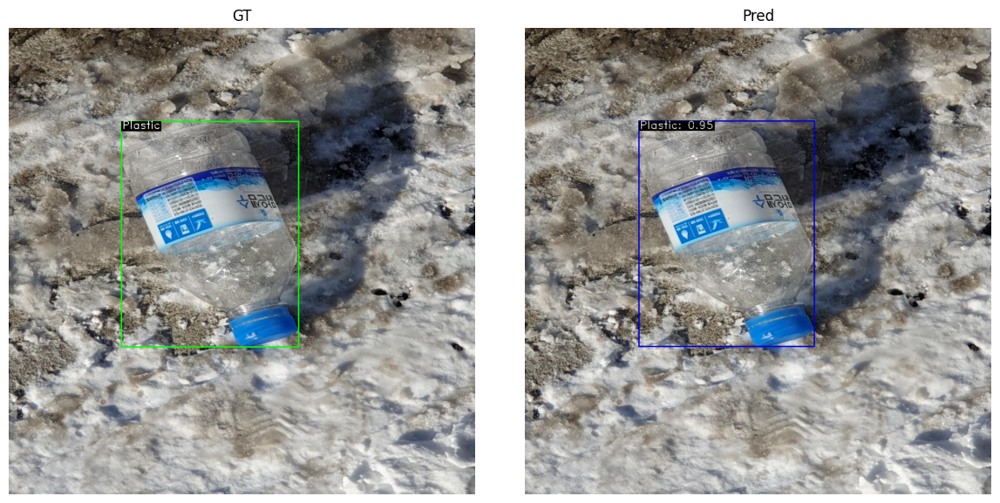

In [13]:

for img_id in range(100, 150):
    fig, axes = plt.subplots(1, 2, figsize=(12, 6)) 
    fig.tight_layout()
    
    boxed_img_from_ann = get_ann_box(img_id, coco, root, mode='train') 
    axes[0].imshow(boxed_img_from_ann) 
    axes[0].set_title('GT')
    axes[0].axis('off')

    boxed_img_from_infer = get_infer_box(model, img_id, root, score_thr=0.3)
    axes[1].imshow(boxed_img_from_infer)
    axes[1].set_title('Pred')
    axes[1].axis('off')
    
    plt.show()

In [14]:
config_file = '/opt/ml/level2_project/baseline/configs/yolox/yolox_x_8x8_300e_coco.py'
model_no_fileter = init_detector(config_file, '/opt/ml/level2_project/baseline/work_dirs/exp10/epoch_17.pth', device='cuda:0')
model_filter = init_detector(config_file, '/opt/ml/level2_project/baseline/work_dirs/exp12/epoch_31.pth', device='cuda:0') 

load checkpoint from local path: /opt/ml/level2_project/baseline/work_dirs/exp10/epoch_17.pth
The model and loaded state dict do not match exactly

unexpected key in source state_dict: ema_backbone_stem_conv_conv_weight, ema_backbone_stem_conv_bn_weight, ema_backbone_stem_conv_bn_bias, ema_backbone_stem_conv_bn_running_mean, ema_backbone_stem_conv_bn_running_var, ema_backbone_stem_conv_bn_num_batches_tracked, ema_backbone_stage1_0_conv_weight, ema_backbone_stage1_0_bn_weight, ema_backbone_stage1_0_bn_bias, ema_backbone_stage1_0_bn_running_mean, ema_backbone_stage1_0_bn_running_var, ema_backbone_stage1_0_bn_num_batches_tracked, ema_backbone_stage1_1_main_conv_conv_weight, ema_backbone_stage1_1_main_conv_bn_weight, ema_backbone_stage1_1_main_conv_bn_bias, ema_backbone_stage1_1_main_conv_bn_running_mean, ema_backbone_stage1_1_main_conv_bn_running_var, ema_backbone_stage1_1_main_conv_bn_num_batches_tracked, ema_backbone_stage1_1_short_conv_conv_weight, ema_backbone_stage1_1_short_conv_bn_w

/opt/ml/baseline/mmdetection/mmdet/apis/inference.py:51: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '


load checkpoint from local path: /opt/ml/level2_project/baseline/work_dirs/exp12/epoch_31.pth
The model and loaded state dict do not match exactly

unexpected key in source state_dict: ema_backbone_stem_conv_conv_weight, ema_backbone_stem_conv_bn_weight, ema_backbone_stem_conv_bn_bias, ema_backbone_stem_conv_bn_running_mean, ema_backbone_stem_conv_bn_running_var, ema_backbone_stem_conv_bn_num_batches_tracked, ema_backbone_stage1_0_conv_weight, ema_backbone_stage1_0_bn_weight, ema_backbone_stage1_0_bn_bias, ema_backbone_stage1_0_bn_running_mean, ema_backbone_stage1_0_bn_running_var, ema_backbone_stage1_0_bn_num_batches_tracked, ema_backbone_stage1_1_main_conv_conv_weight, ema_backbone_stage1_1_main_conv_bn_weight, ema_backbone_stage1_1_main_conv_bn_bias, ema_backbone_stage1_1_main_conv_bn_running_mean, ema_backbone_stage1_1_main_conv_bn_running_var, ema_backbone_stage1_1_main_conv_bn_num_batches_tracked, ema_backbone_stage1_1_short_conv_conv_weight, ema_backbone_stage1_1_short_conv_bn_w

/opt/ml/baseline/mmdetection/mmdet/apis/inference.py:51: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '


In [ ]:
for img_id in range(100, 150):
    fig, axes = plt.subplots(1, 2, figsize=(12, 6)) 
    fig.tight_layout()
    
    boxed_img_from_infer = get_infer_box(model_no_fileter, img_id, root, score_thr=0.3) 
    axes[0].imshow(boxed_img_from_ann) 
    axes[0].set_title('No filter')
    axes[0].axis('off')

    boxed_img_from_infer = get_infer_box(model_filter, img_id, root, score_thr=0.3)
    axes[1].imshow(boxed_img_from_infer)
    axes[1].set_title('filter')
    axes[1].axis('off')
    
    plt.show()